## Airport Scheduling Problem 

### simplifying assumptions
- airport only "open" between 6:00 AM and 11:59 PM  


### Process Description 
* The airport environment is modelled as a Markov Decision Process, including
    * Stages / Time: $t$
        * Time steps in hours
        * $t = 0, 1, 2, ..., T$
    * States: $x_t$
        * Number of arriving passengers waiting in the queue (customs) given time step
        * $x_t = 0, 1, 2, ..., \text{waiting capacity}$
    * Actions: $u_t$
        * Number of on-demand customs officers to hire given time step
        * Is not defined for $t=T$ (airport closed)
        * $u_t = 0, 1, 2, ..., \text{max number of customs officers}$
    * Transitions: $f_t(x_t, u_t)$
        * Characterisation of state in next period
        * $x_{t+1}=f(x_t,u_t)=[x_t+d_t-S(u_t+2)]^+$
            * $d_t$ is the number of passengers arriving to customs area in the current hour
                * Follows:
                    * 1) the poisson distribution at t for a stochastic transition, where lambdas are modeled from historical data
                      2) a deterministic arrival schedule based on historical data
            * The formula assmued airport already has 2 permanent customs officers, and each can check on average $S$ passengers 
    * Costs: $g_t, g_T$
        * Cost per Stage: $g_t(x_t, u_t)$
            * If Cost of on-demand customs officer is 500/doc-hour; cost of one passenger waiting per hour is 30:
                * $g_t(x_t, u_t) = 500u_t + 30x_t$
        * Terminal Cost: $g_T(x_T)$
            * If there are still passengers waiting at the end of the day, the airport will incur a cost of 300 per passenger:
                * $g_T(x_T) = 300x_T$
            
    



### Here we solve the airport scheduling problem backward induction.


- Clinic opens at 8am, and closes at 8pm
- w = 200 (patient waiting cost, per patient per hour)
- W = 400 (abandonment cost of not treating a patient)
- wage = 500 per on-demand doctor per hour (there are 10 doctors already scheduled for each hour, and you can ignore their wage since that doesn't change the calculations)
- patient arrival process: at the beginning of every hour t, D_t patients arrive. All the D_t's are i.i.d. Poisson random variables with lambda = 5.
- The initial number of patient (x_1) is anywhere between 0 and 70. (Think of these patients as having arrived before 8am and been waiting)

In [1]:
'''
Building the Airport Environment
'''

from hospital_env import HospitalEnv as AirportEnv
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import poisson
from matplotlib_inline.backend_inline import set_matplotlib_formats
from utils import *
from time import time
set_matplotlib_formats('svg', 'pdf')


### Based on historical data, set lambdas for morning, afternoon, evening

In [2]:
# load data
df_jfk = collect_data(["jfk/jfk_2022.csv", "jfk/jfk_2023.csv"])
df_jfk.head()

,FlightDate,HourRange,TotalPassengerCount,AverageWait,BoothsUsed,FlightCount,Hour,WeekDay,Month,time_of_day
0,2022-01-01,0500 - 0600,86,36,10,1,5,Saturday,January,night
1,2022-01-01,0600 - 0700,489,14,17,2,6,Saturday,January,morning
2,2022-01-01,0700 - 0800,803,19,16,4,7,Saturday,January,morning
3,2022-01-01,0800 - 0900,309,27,12,1,8,Saturday,January,morning
4,2022-01-01,1100 - 1200,189,17,10,1,11,Saturday,January,morning


In [3]:
df_jfk.describe()

,FlightDate,TotalPassengerCount,AverageWait,BoothsUsed,FlightCount,Hour
count,11047,11047.000000,11047.000000,11047.000000,11047.000000,11047.000000
mean,2023-01-16 18:00:21.508101888,480.774418,24.644609,13.823934,2.230560,14.008419
min,2022-01-01 00:00:00,6.000000,0.000000,1.000000,1.000000,0.000000
25%,2022-07-24 00:00:00,257.000000,15.000000,11.000000,1.000000,9.000000
50%,2023-01-24 00:00:00,425.000000,21.000000,14.000000,2.000000,14.000000
75%,2023-07-15 00:00:00,658.000000,31.000000,17.000000,3.000000,19.000000
max,2023-12-31 00:00:00,1934.000000,120.000000,27.000000,8.000000,23.000000
std,NaN,292.776922,13.800408,4.092898,1.214455,5.469735


### Scenario 1: Overall arrival rates given the time of the day for a whole year. There are 4 arrival rates associated to night, morning, afternoon and evening

In [4]:
# Set the mean (lambda) for the Poisson distribution given historic data

arrival_distrib_timeofday = [shift_arrival_rate(df_jfk, time_of_day=time,  day=None, month=None) for time in ['night', 'morning', 'afternoon', 'evening']]
# repeat the hourly rates 6 times
arrival_distrib_time = []
for rate in arrival_distrib_timeofday:
    arrival_distrib_time += 6*[rate]

# arrival_distrib
print("Arrival Distribution time of day: ", arrival_distrib_time)

# Service rate
service_rate_value = service_rate(df_jfk)
print("Service Rate: ", service_rate_value)

Arrival Distribution time of day:  [469, 469, 469, 469, 469, 469, 427, 427, 427, 427, 427, 427, 554, 554, 554, 554, 554, 554, 440, 440, 440, 440, 440, 440]
Service Rate:  43.04479791616462


c:\Users\simon\OneDrive - andrew.cmu.edu\Classes\Fall_2024\Decision Analytics\FinalProject\cbp_scheduling\utils.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ServiceRate'] = df['TotalPassengerCount'] / df['BoothsUsed']


Setup the environment

In [ ]:
# Initialize the environment
arrival_distrib=arrival_distrib_time
open_time=6
work_hours=18
passenger_waiting_cost=30
booth_cost=500
boot_fixed_cost = 250
waiting_capacity= 1000 #658 # Percentle 75 of the number of passengers in the airport
max_on_demand_booth= 27 # Max historical capacity 
passenger_not_attended_cost= 300
default_queue_length=0

# set up object 
airport_env_time_of_day_year = AirportEnv(arrival_distrib=arrival_distrib,
                                            open_time=open_time,
                                            work_hours=work_hours,
                                            patient_waiting_cost=passenger_waiting_cost,
                                            doc_cost=booth_cost,
                                            waiting_capacity=waiting_capacity,
                                            max_on_demand_doc=max_on_demand_booth,
                                            patient_not_treated_cost=passenger_not_attended_cost,
                                            default_queue_length=default_queue_length)

Run the Stochastic Backward Induction Algorithm

In [6]:
'''
Run the Stochastic Backward Induction Algorithm
'''
from BI_solver_sto import BISolverSto

solver_sto_1 = BISolverSto(env = airport_env_time_of_day_year)
start = time()
policy_sto_1, cost_sto_1 = solver_sto_1.backward_induction()
runtime_sto_1 = time() - start

# save policy as df
pd.DataFrame(policy_sto_1).to_csv(f"optimal_policy_airport_env_time_of_day_year.csv")
# save cost to go as df 
pd.DataFrame(cost_sto_1).to_csv("optimal_ctg_airport_env_time_of_day_year.csv")

-----processing state 17
index process took: 43.537
-----processing state 16
index process took: 44.381
-----processing state 15
index process took: 44.498
-----processing state 14
index process took: 44.536
-----processing state 13
index process took: 44.162
-----processing state 12
index process took: 44.381
-----processing state 11
index process took: 44.263
-----processing state 10
index process took: 43.966
-----processing state 9
index process took: 43.913
-----processing state 8
index process took: 43.732
-----processing state 7
index process took: 44.114
-----processing state 6
index process took: 44.084
-----processing state 5
index process took: 44.629
-----processing state 4
index process took: 44.098
-----processing state 3
index process took: 43.898
-----processing state 2
index process took: 43.964
-----processing state 1
index process took: 43.615
-----processing state 0
index process took: 44.101


Optimal Policy Visualized

In [7]:
# visualize the policy 
airport_env_time_of_day_year.visualize_policy(policy_sto_1, "Stochastic Policy")

# visualize the cost to go
airport_env_time_of_day_year.visualize_cost(cost_sto_1, title='Value Function of the Policy (Stochastic)')

### Scenario 2: Overall arrival rates given the hour of the day for a whole year. Each hour has a different arrival rate.

In [8]:
# Set the mean (lambda) for the Poisson distribution given historic data

arrival_distrib_hourly = [hourly_arrival_rate(df_jfk, hour=hour, day=None, month=None) for hour in range(24)]

# arrival_distrib
print("Arrival Distribution hourly: ", arrival_distrib_hourly)

# Service rate
service_rate_value = service_rate(df_jfk)
print("Service Rate: ", service_rate_value)

Arrival Distribution hourly:  [154, 92, 9, 9, 229, 505, 692, 411, 322, 263, 231, 347, 417, 577, 716, 672, 460, 477, 489, 537, 378, 435, 448, 246]
Service Rate:  43.04479791616462


c:\Users\simon\OneDrive - andrew.cmu.edu\Classes\Fall_2024\Decision Analytics\FinalProject\cbp_scheduling\utils.py:122: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ServiceRate'] = df['TotalPassengerCount'] / df['BoothsUsed']


Setup the environment

In [9]:
# Initialize the environment
arrival_distrib=arrival_distrib_hourly
# open_time=6
# work_hours=18
# passenger_waiting_cost=500
# booth_cost=100
# boot_fixed_cost = 250
# waiting_capacity=500
# max_on_demand_booth=50 
# passenger_not_attended_cost=1000
# default_queue_length=0

# set up object 
airport_env_hourly_year = AirportEnv(arrival_distrib=arrival_distrib,
                                            open_time=open_time,
                                            work_hours=work_hours,
                                            patient_waiting_cost=passenger_waiting_cost,
                                            doc_cost=booth_cost,
                                            waiting_capacity=waiting_capacity,
                                            max_on_demand_doc=max_on_demand_booth,
                                            patient_not_treated_cost=passenger_not_attended_cost,
                                            default_queue_length=default_queue_length)

Run the Stochastic Backward Induction Algorithm

In [ ]:
'''
Run the Stochastic Backward Induction Algorithm
'''
from BI_solver_sto import BISolverSto

solver_sto_2 = BISolverSto(env = airport_env_hourly_year)
start = time()
policy_sto_2, cost_sto_2 = solver_sto_2.backward_induction()
runtime_sto_2 = time() - start

# save policy as df
pd.DataFrame(policy_sto_2).to_csv(f"optimal_policy_airport_env_hourly.csv")
# save cost to go as df 
pd.DataFrame(cost_sto_2).to_csv("optimal_ctg_airport_env_hourly.csv")

-----processing state 17
index process took: 46.397
-----processing state 16
index process took: 44.582
-----processing state 15
index process took: 44.325
-----processing state 14
index process took: 44.039
-----processing state 13
index process took: 44.213
-----processing state 12
index process took: 44.149
-----processing state 11
index process took: 44.967
-----processing state 10
index process took: 48.233
-----processing state 9
index process took: 45.466
-----processing state 8
index process took: 43.995
-----processing state 7
index process took: 44.216
-----processing state 6
index process took: 44.032
-----processing state 5
index process took: 43.813
-----processing state 4
index process took: 43.681
-----processing state 3
index process took: 44.568
-----processing state 2
index process took: 43.846
-----processing state 1
index process took: 43.63
-----processing state 0
index process took: 43.715


Optimal Policy Visualized

In [11]:
# visualize the policy 
airport_env_hourly_year.visualize_policy(policy_sto_2, "Stochastic Policy")

# visualize the cost to go
airport_env_hourly_year.visualize_cost(cost_sto_2, title='Value Function of the Policy (Stochastic)')

### Scenario 3: Monthly arrival rates given the time of the day. There are 4 arrival rates associated to night, morning, afternoon and evening per month.

In [12]:
# Set the mean (lambda) for the Poisson distribution given historic data for each month
list_time_of_day = ['night', 'morning', 'afternoon', 'evening']

for month in ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']:
    arrival_distrib_timeofday = [shift_arrival_rate(df_jfk, time_of_day=time,  day=None, month=month) for time in list_time_of_day]
    # repeat the hourly rates 6 times
    arrival_distrib_time_monthly = []
    for rate in arrival_distrib_timeofday:
        arrival_distrib_time_monthly += 6*[rate]

    # arrival_distrib
    print(f"Arrival Distribution time of day for {month}: ", arrival_distrib_time_monthly)

    # Initialize the environment
    exec(f"arrival_distrib_time_{month}=arrival_distrib_time_monthly")

    arrival_distrib=arrival_distrib_time_monthly

    # set up object 
    airport_env_time_of_day_month = AirportEnv(arrival_distrib=arrival_distrib,
                                                open_time=open_time,
                                                work_hours=work_hours,
                                                patient_waiting_cost=passenger_waiting_cost,
                                                doc_cost=booth_cost,
                                                waiting_capacity=waiting_capacity,
                                                max_on_demand_doc=max_on_demand_booth,
                                                patient_not_treated_cost=passenger_not_attended_cost,
                                                default_queue_length=default_queue_length)

    '''
    Run the Stochastic Backward Induction Algorithm
    '''
    from BI_solver_sto import BISolverSto

    exec(f"solver_sto_3_{month} = BISolverSto(env = airport_env_time_of_day_month)")
    start = time()
    exec(f"policy_sto_3_{month}, cost_sto_3_{month} = solver_sto_3_{month}.backward_induction()")
    exec(f"runtime_sto_3_{month} = time() - start")

    # save policy as df
    pd.DataFrame(eval(f"policy_sto_3_{month}")).to_csv(f"optimal_policy_airport_env_time_of_day_{month}.csv")
    # save cost to go as df 
    pd.DataFrame(eval(f"cost_sto_3_{month}")).to_csv(f"optimal_ctg_airport_env_time_of_day_{month}.csv")

Arrival Distribution time of day for January:  [326, 326, 326, 326, 326, 326, 443, 443, 443, 443, 443, 443, 396, 396, 396, 396, 396, 396, 346, 346, 346, 346, 346, 346]
-----processing state 17
index process took: 157.645
-----processing state 16
index process took: 156.782
-----processing state 15
index process took: 156.175
-----processing state 14
index process took: 157.073
-----processing state 13
index process took: 156.468
-----processing state 12
index process took: 159.338
-----processing state 11
index process took: 156.262
-----processing state 10
index process took: 156.458
-----processing state 9
index process took: 155.655
-----processing state 8
index process took: 157.08
-----processing state 7
index process took: 154.924
-----processing state 6
index process took: 156.632
-----processing state 5
index process took: 156.632
-----processing state 4
index process took: 156.612
-----processing state 3
index process took: 156.182
-----processing state 2
index process took: 1

### Scenario 4: Overall arrival rates given the time of the day for a whole year. There are 4 arrival rates associated to night, morning, afternoon and evening - DETERMINISTIC

Run the Deterministic Backward Induction Algorithm

In [16]:
'''
Run the Deterministic Backward Induction Algorithm
'''
from BI_solver_det import BISolverDet

solver_det_1 = BISolverDet(env = airport_env_time_of_day_year)
start = time()
policy_det_1, cost_det_1 = solver_det_1.backward_induction()
runtime_det_1 = time() - start

# save policy as df
pd.DataFrame(policy_det_1).to_csv(f"optimal_policy_airport_env_time_of_day_year_det.csv")
# save cost to go as df 
pd.DataFrame(cost_det_1).to_csv("optimal_ctg_airport_env_time_of_day_year_det.csv")

IndexError: invalid index to scalar variable.

Optimal Policy Visualized

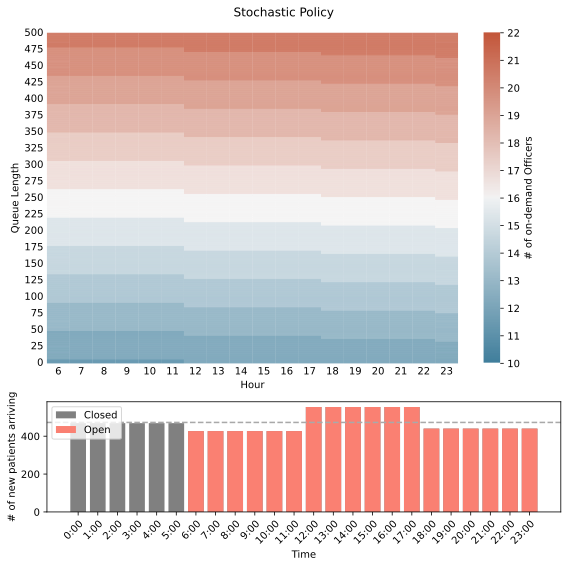

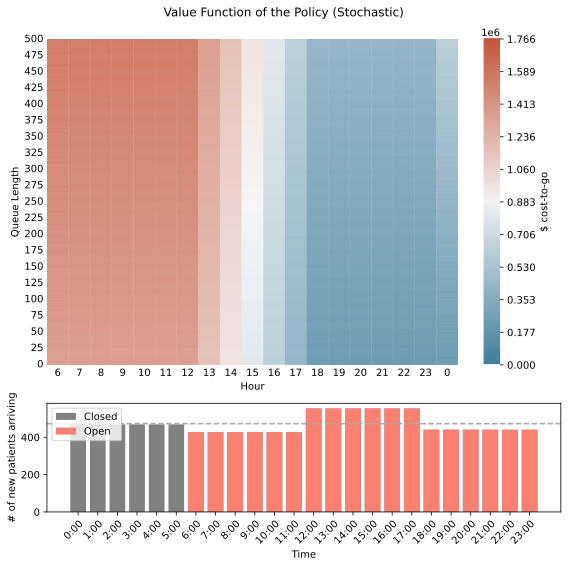

In [ ]:
# visualize the policy 
airport_env_time_of_day_year.visualize_policy(policy_det_1, "Stochastic Policy")

# visualize the cost to go
airport_env_time_of_day_year.visualize_cost(cost_det_1, title='Value Function of the Policy (Stochastic)')

### Scenario 5: Overall arrival rates given the hour of the day for a whole year. Each hour has a different arrival rate. DETERMINISTIC

Run the Stochastic Backward Induction Algorithm

In [ ]:
'''
Run the Deterministic Backward Induction Algorithm
'''

solver_det_2 = BISolverDet(env = airport_env_hourly_year)
start = time()
policy_det_2, cost_det_2 = solver_det_2.backward_induction()
runtime_det_2 = time() - start

# save policy as df
pd.DataFrame(policy_det_2).to_csv(f"optimal_policy_airport_env_time_of_day_year_det.csv")
# save cost to go as df 
pd.DataFrame(cost_det_2).to_csv("optimal_ctg_airport_env_time_of_day_year_det.csv")

-----processing state 17
index process took: 82.711
-----processing state 16
index process took: 158.497
-----processing state 15
index process took: 57.799
-----processing state 14
index process took: 43.292
-----processing state 13
index process took: 43.332
-----processing state 12
index process took: 43.684
-----processing state 11
index process took: 79.101
-----processing state 10
index process took: 158.26
-----processing state 9
index process took: 159.998
-----processing state 8
index process took: 158.862
-----processing state 7
index process took: 158.986
-----processing state 6
index process took: 158.003
-----processing state 5
index process took: 159.384
-----processing state 4
index process took: 157.623
-----processing state 3
index process took: 158.136
-----processing state 2
index process took: 157.318
-----processing state 1
index process took: 158.28
-----processing state 0
index process took: 158.062


Optimal Policy Visualized

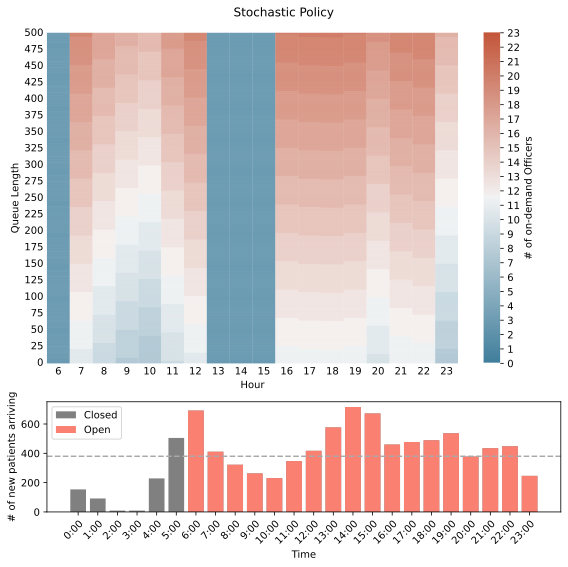

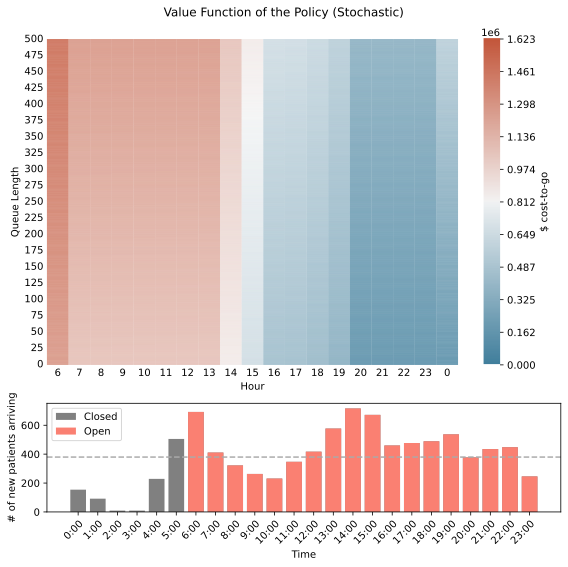

In [ ]:
# visualize the policy 
airport_env_hourly_year.visualize_policy(policy_det_2, "Stochastic Policy")

# visualize the cost to go
airport_env_hourly_year.visualize_cost(cost_det_2, title='Value Function of the Policy (Stochastic)')

### Scenario 6: Monthly arrival rates given the time of the day. There are 4 arrival rates associated to night, morning, afternoon and evening per month.

In [ ]:
# Set the mean (lambda) for the Poisson distribution given historic data for each month
list_time_of_day = ['night', 'morning', 'afternoon', 'evening']

for month in ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']:
    arrival_distrib_timeofday = [hourly_arrival_rate(df_jfk, time_of_day=time,  day=None, month=month) for time in list_time_of_day]
    # repeat the hourly rates 6 times
    arrival_distrib_time_monthly = []
    for rate in arrival_distrib_timeofday:
        arrival_distrib_time_monthly += 6*[rate]

    # arrival_distrib
    print(f"Arrival Distribution time of day for {month}: ", arrival_distrib_time_monthly)

    # Initialize the environment
    exec(f"arrival_distrib_time_{month}=arrival_distrib_time_monthly_det")

    arrival_distrib=arrival_distrib_time_monthly

    # set up object 
    airport_env_time_of_day_month = AirportEnv(arrival_distrib=arrival_distrib,
                                                open_time=open_time,
                                                work_hours=work_hours,
                                                patient_waiting_cost=passenger_waiting_cost,
                                                doc_cost=booth_cost,
                                                waiting_capacity=waiting_capacity,
                                                max_on_demand_doc=max_on_demand_booth,
                                                patient_not_treated_cost=passenger_not_attended_cost,
                                                default_queue_length=default_queue_length)

    '''
    Run the Deterministic Backward Induction Algorithm
    '''

    exec(f"solver_det_3_{month} = BISolverDet(env = airport_env_time_of_day_month)")
    start = time()
    exec(f"policy_det_3_{month}, cost_det_3_{month} = solver_det_3_{month}.backward_induction()")
    exec(f"runtime_det_3_{month} = time() - start")

    # save policy as df
    pd.DataFrame(eval(f"policy_det_3_{month}")).to_csv(f"optimal_policy_airport_env_time_of_day_{month}.csv")
    # save cost to go as df 
    pd.DataFrame(eval(f"cost_det_3_{month}")).to_csv(f"optimal_ctg_airport_env_time_of_day_{month}.csv")

Arrival Distribution time of day for January:  [326, 326, 326, 326, 326, 326, 443, 443, 443, 443, 443, 443, 396, 396, 396, 396, 396, 396, 346, 346, 346, 346, 346, 346]
-----processing state 17
index process took: 157.645
-----processing state 16
index process took: 156.782
-----processing state 15
index process took: 156.175
-----processing state 14
index process took: 157.073
-----processing state 13
index process took: 156.468
-----processing state 12
index process took: 159.338
-----processing state 11
index process took: 156.262
-----processing state 10
index process took: 156.458
-----processing state 9
index process took: 155.655
-----processing state 8
index process took: 157.08
-----processing state 7
index process took: 154.924
-----processing state 6
index process took: 156.632
-----processing state 5
index process took: 156.632
-----processing state 4
index process took: 156.612
-----processing state 3
index process took: 156.182
-----processing state 2
index process took: 1

## Apply optimal policy to real world data - What Cost Would the Terminal have Incurred from running this policy over the course of 2023?

In [13]:
year_to_analyze = 2023

# extract hourly arrivals for every day in 2023
#filter the data for 2022
df_jfk_year_to_analyze = df_jfk[df_jfk['FlightDate'].dt.year == year_to_analyze]
arrival_dist_set = []
for date in df_jfk_year_to_analyze['FlightDate'].unique():
    daily_arrivals = []
    for hour in range(24):
        passenger_count = df_jfk_year_to_analyze[(df_jfk_year_to_analyze['FlightDate'] == date) & (df_jfk_year_to_analyze['Hour'] == hour)]['TotalPassengerCount']
        if not passenger_count.empty:
            daily_arrivals.append(passenger_count.values[0])
        else:
            daily_arrivals.append(0)
    arrival_dist_set.append(daily_arrivals)


In [14]:
def simulate_real(policy, env, arrival_dist_set):
    '''
    Simulate the environment with the given policy,
    the policy must be a discrete table.

    Return the average cost
    '''
    print(f"[ Simulating for {len(arrival_dist_set)} episodes... ]")

    total_cost = 0

    # Simulate the environment for num_sim times
    for arr in arrival_dist_set:
        # Reset the environment
        x_t, _ = env.reset()
        # overwrite arriaval dist
        env.arrival_dist = arr
        # set other vars
        cost, done, t = 0, False, 0
        # Iterate through all time steps
        while not done:
            # Take the action given by the policy
            u_t = policy[x_t][t]
            # Take a step in the environment
            (x_t, _), step_cost, done = env.step(u_t)
            cost += step_cost
            t += 1
        # Add the cost
        total_cost += cost

    return total_cost / len(arrival_dist_set)

[ Simulating for 365 episodes... ]
  * 418 new passengers arrived
  * Using 10 on-demand officers
  * 404 new passengers arrived
  * Using 10 on-demand officers
  * 423 new passengers arrived
  * Using 10 on-demand officers
  * 430 new passengers arrived
  * Using 10 on-demand officers
  * 440 new passengers arrived
  * Using 10 on-demand officers
  * 404 new passengers arrived
  * Using 10 on-demand officers
  * 583 new passengers arrived
  * Using 11 on-demand officers
  * 574 new passengers arrived
  * Using 12 on-demand officers
  * 532 new passengers arrived
  * Using 12 on-demand officers
  * 532 new passengers arrived
  * Using 12 on-demand officers
  * 567 new passengers arrived
  * Using 11 on-demand officers
  * 566 new passengers arrived
  * Using 12 on-demand officers
  * 423 new passengers arrived
  * Using 13 on-demand officers
  * 457 new passengers arrived
  * Using 11 on-demand officers
  * 442 new passengers arrived
  * Using 11 on-demand officers
  * 438 new passenge

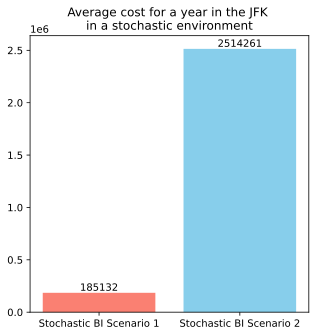

In [17]:
# simulate outcome if optimal policy was applied in 2023
from tools import simulate_real, plot_scores

average_cost_1 = simulate_real(policy_sto_1, airport_env_time_of_day_year, arrival_dist_set)
average_cost_2 = simulate_real(policy_sto_2, airport_env_hourly_year, arrival_dist_set)
# average_cost_det_1 = simulate_real(policy_det_1, airport_env_time_of_day_year, arrival_dist_set)
# average_cost_det_2 = simulate_real(policy_det_2, airport_env_hourly_year, arrival_dist_set)

plot_scores([average_cost_1, average_cost_2
            #  , average_cost_det_1, average_cost_det_2
             ], 
            ["Stochastic BI Scenario 1", "Stochastic BI Scenario 2"
            #  , "Deterministic BI Scenario 1", "Deterministic BI Scenario 2"
             ], 
            f"Average cost for a year in the JFK \nin a stochastic environment")

In [26]:
df_jfk_year_to_analyze = df_jfk[df_jfk['FlightDate'].dt.year == year_to_analyze]

# for each month create a list of daily arrivals
arrival_dist_set_monthly = {}
for month in df_jfk_year_to_analyze['Month'].unique():
    arrival_dist_set_monthly[month] = []
    df_jfk_month = df_jfk_year_to_analyze[df_jfk_year_to_analyze['Month'] == month]
    for date in df_jfk_month['FlightDate'].unique():
        daily_arrivals = []
        for hour in range(24):
            passenger_count = df_jfk_month[(df_jfk_month['FlightDate'] == date) & (df_jfk_month['Hour'] == hour)]['TotalPassengerCount']
            if not passenger_count.empty:
                daily_arrivals.append(passenger_count.values[0])
            else:
                daily_arrivals.append(0)
        arrival_dist_set_monthly[month].append(daily_arrivals)

#simulate outcome if optimal policy 3 was applied in 2023
average_cost_monthly = {}
for month in arrival_dist_set_monthly.keys():
    average_cost_monthly[month] = simulate_real(eval(f"policy_sto_3_{month}"), airport_env_hourly_year, arrival_dist_set_monthly[month][0])

# Estimate the average cost for the year with the monthly average cost
average_cost_year_monthly = np.mean(list(average_cost_monthly.values()))


[ Simulating for 24 episodes... ]
  * 696 new passengers arrived
  * Using 11 on-demand officers
  * 413 new passengers arrived
  * Using 15 on-demand officers
  * 361 new passengers arrived
  * Using 11 on-demand officers
  * 277 new passengers arrived
  * Using 11 on-demand officers
  * 220 new passengers arrived
  * Using 11 on-demand officers
  * 378 new passengers arrived
  * Using 11 on-demand officers
  * 455 new passengers arrived
  * Using 10 on-demand officers
  * 593 new passengers arrived
  * Using 10 on-demand officers
  * 706 new passengers arrived
  * Using 12 on-demand officers
  * 686 new passengers arrived
  * Using 16 on-demand officers
  * 509 new passengers arrived
  * Using 15 on-demand officers
  * 466 new passengers arrived
  * Using 11 on-demand officers
  * 472 new passengers arrived
  * Using 8 on-demand officers
  * 530 new passengers arrived
  * Using 10 on-demand officers
  * 366 new passengers arrived
  * Using 12 on-demand officers
  * 448 new passengers

[ Simulating for 365 episodes... ]
  * 449 new passengers arrived
  * Using 10 on-demand officers
  * 417 new passengers arrived
  * Using 10 on-demand officers
  * 429 new passengers arrived
  * Using 10 on-demand officers
  * 429 new passengers arrived
  * Using 10 on-demand officers
  * 454 new passengers arrived
  * Using 10 on-demand officers
  * 418 new passengers arrived
  * Using 10 on-demand officers
  * 572 new passengers arrived
  * Using 11 on-demand officers
  * 536 new passengers arrived
  * Using 12 on-demand officers
  * 556 new passengers arrived
  * Using 11 on-demand officers
  * 578 new passengers arrived
  * Using 12 on-demand officers
  * 589 new passengers arrived
  * Using 13 on-demand officers
  * 548 new passengers arrived
  * Using 12 on-demand officers
  * 457 new passengers arrived
  * Using 12 on-demand officers
  * 421 new passengers arrived
  * Using 11 on-demand officers
  * 457 new passengers arrived
  * Using 11 on-demand officers
  * 455 new passenge

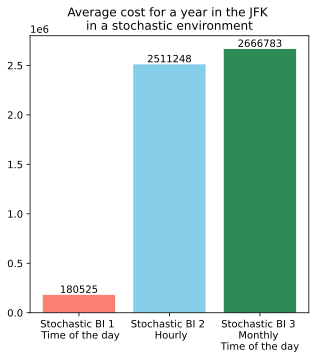

In [30]:
average_cost_1 = simulate_real(policy_sto_1, airport_env_time_of_day_year, arrival_dist_set)
average_cost_2 = simulate_real(policy_sto_2, airport_env_hourly_year, arrival_dist_set)

plot_scores([average_cost_1, average_cost_2, average_cost_year_monthly], 
            ["Stochastic BI 1 \n Time of the day", "Stochastic BI 2 \n Hourly", "Stochastic BI 3 \nMonthly \nTime of the day"], 
            f"Average cost for a year in the JFK \nin a stochastic environment")

In [31]:
average_cost_monthly

{'January': 572454.1666666666,
 'February': 684145.8333333334,
 'March': 405258.3333333333,
 'April': 4199054.166666667,
 'May': 445875.0,
 'June': 4131900.0,
 'July': 4126204.1666666665,
 'August': 8359195.833333333,
 'September': 4155779.1666666665,
 'October': 4142345.8333333335,
 'November': 397654.1666666667,
 'December': 381537.5}

In [35]:
list(average_cost_monthly.values())

[572454.1666666666,
 684145.8333333334,
 405258.3333333333,
 4199054.166666667,
 445875.0,
 4131900.0,
 4126204.1666666665,
 8359195.833333333,
 4155779.1666666665,
 4142345.8333333335,
 397654.1666666667,
 381537.5]